In [26]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import datetime
import seaborn as sns
import my_funcs as mf

plt.rcParams['mathtext.fontset'] = 'stix'
plt.rcParams['font.family'] = 'STIXGeneral'

## 1) LOAD AND VISUALIZE THE DATA

In [27]:
# Read the excel file
V52_data_raw = pd.read_excel('V52_exel.xlsx')

In [28]:
# Convert the date column to datetime format
V52_data_raw.index = pd.to_datetime(V52_data_raw['Date'], format='%Y%m%d%H%M')


In [29]:
#d Describe the data frame to see the statistics of the data
print(V52_data_raw.describe())

# NOTE: counts how many nans we have in the wsp_44m column !!!

               Date       Wsp_44m      Wdir_41m        ActPow         RePow  \
count  5.224100e+04  48988.000000  48988.000000  52103.000000  52103.000000   
mean   2.018067e+11      5.595770    192.776609    139.070329     -0.071636   
std    3.474519e+06      2.796707     88.910389    203.275309      0.634039   
min    2.018010e+11      0.503833      0.001286    -27.466700     -5.744410   
25%    2.018040e+11      3.626873    125.051750     -0.400000     -0.002700   
50%    2.018070e+11      5.185345    198.823000     57.400500     -0.000527   
75%    2.018100e+11      7.081175    266.270000    175.286000      0.002410   
max    2.019010e+11     19.720000    359.997000    867.900000     11.800000   

         ActPow_std   Wsp_44m_std  Wdir_41m_std     stability  
count  52103.000000  48988.000000  48988.000000  52241.000000  
mean      36.724520      0.823869      8.386558      0.513677  
std       46.100481      0.520168      4.740973      0.499818  
min        0.000000      0.00000

Because the data from the met-mast is the limiting one, we should first of all put to nan the rest of the rows from the data frame 

In [30]:
# the rows which have nan values in the wsp_44m column will be put to nan Except for date
V52_data_raw.loc[V52_data_raw['Wsp_44m'].isnull(), V52_data_raw.columns != 'Date'] = np.nan
# same problem the other way around
V52_data_raw.loc[V52_data_raw['ActPow'].isnull(), V52_data_raw.columns != 'Date'] = np.nan

print(V52_data_raw.describe())



               Date       Wsp_44m      Wdir_41m        ActPow         RePow  \
count  5.224100e+04  48850.000000  48850.000000  48850.000000  48850.000000   
mean   2.018067e+11      5.576675    192.635707    144.472955     -0.068813   
std    3.474519e+06      2.776049     88.923497    207.577375      0.616599   
min    2.018010e+11      0.503833      0.001286    -27.466700     -5.744410   
25%    2.018040e+11      3.622665    124.865250     -0.390690     -0.002633   
50%    2.018070e+11      5.175870    198.935000     60.128300     -0.000510   
75%    2.018100e+11      7.055505    266.137750    183.379000      0.002380   
max    2.019010e+11     19.720000    359.997000    867.900000     11.800000   

         ActPow_std   Wsp_44m_std  Wdir_41m_std     stability  
count  48850.000000  48850.000000  48850.000000  48850.000000  
mean      37.861227      0.826052      8.409560      0.546551  
std       46.892570      0.519013      4.727177      0.497833  
min        0.000000      0.00000

In [31]:
# See how many elements are missing from the wind speed column 
# NOTE: that not all the columns have the same number of missing elements

print(V52_data_raw['Wsp_44m'].isna().sum())
print(V52_data_raw['ActPow'].isna().sum())

3391
3391


In [32]:
# plot wind speed data with plotly

fig = px.line(V52_data_raw, x=V52_data_raw.index, y='Wsp_44m')
fig.update_layout(title='Wind Speed (m/s) of V52')
fig.show()

# scatter plot of wind speed vs power
fig = px.scatter(V52_data_raw, x='Wsp_44m', y='ActPow')
fig.update_layout(title='Wind Speed vs Power of V52')
fig.show()


c:\Users\enriq\AppData\Local\Programs\Python\Python310\lib\site-packages\_plotly_utils\basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



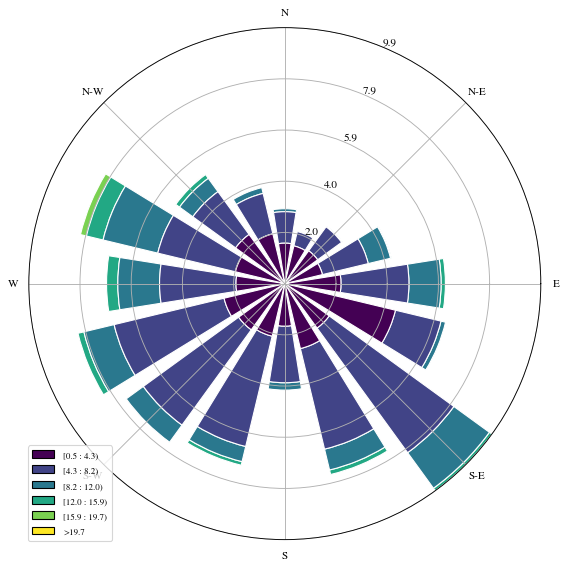

In [33]:
# Wind Rose plot -->  This will be important for the power prediction
import windrose

wd = V52_data_raw['Wdir_41m']
ws = V52_data_raw['Wsp_44m']
ax = windrose.WindroseAxes.from_ax()
ax.bar(wd, ws, normed=True, opening=0.8, edgecolor='white')
ax.set_legend()
plt.show()

## 2) CLEANING THE RAW DATA

In [34]:
# Make a copy where we are going to make the cleaning
V52_data = V52_data_raw.copy()

In [35]:
# 1) SET TO NAN WHENEVER WIND SPEED HAS A NAN VALUE THE REST OF THE COLUMNS EXCEPT THE DATE
# Identify rows where 'Wsp_44m' contains NaN
#condition = V52_data['Wsp_44m'].isna()

# Set values to NaN for the entire row (except 'Date') where the condition is True
#V52_data.loc[condition, V52_data.columns] = np.nan

In [36]:
# 2) PUT TO NAN VARAIBLES THAT HAVE A STD = 0 ---> very very unlikely that in 10 min the variable was stationary

# Wind Speed
V52_data.loc[V52_data['Wsp_44m_std'] == 0, V52_data.columns] = np.nan

# Wind direction
V52_data.loc[V52_data['Wdir_41m_std'] == 0, V52_data.columns] = np.nan


In [37]:
#V52_data.describe()

In [38]:
# 3) FILTER EXTREME VALUES

LowestWindSpeed = 0.01   # [m/s] anemometer's calm threshold
CrazyWind = 50           # [m/s] 10-minute-mean wind in Denmark has never been this high

V52_data.loc[V52_data['Wsp_44m'] < LowestWindSpeed, V52_data.columns] = np.nan
V52_data.loc[V52_data['Wsp_44m'] > CrazyWind, V52_data.columns] = np.nan

In [39]:
# 4) DISREGARD NEGATIVE POWERS (AS WE ARE ONLY INTERESTED IN THE POWER PRODUCED BY THE TURBINE)
V52_data.loc[V52_data['ActPow'] < 0, V52_data.columns] = np.nan

In [40]:
#V52_data.describe()

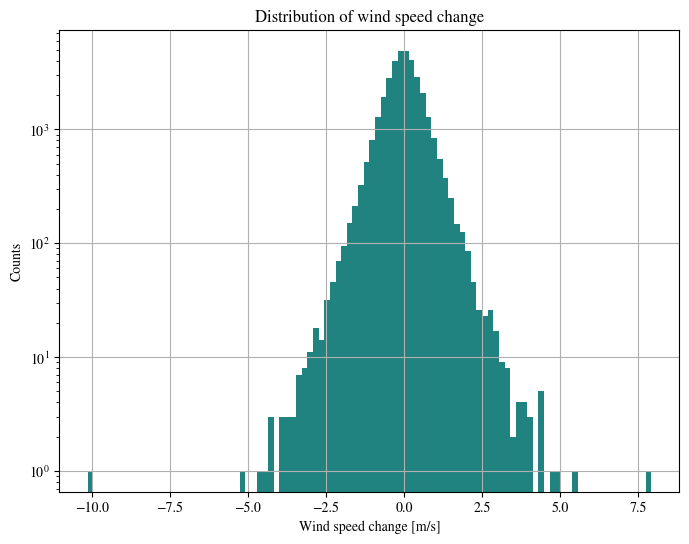

In [41]:
# 5) FILTER SUDDEN CHANGES ON WIND SPEED

# In order to choose a proper value for this... let's plot the distribution of changes in wind speed

plt.figure(figsize=(8, 6))
plt.hist(np.diff(V52_data['Wsp_44m']), bins=100, color='#218380')

plt.yscale('log')
plt.grid(True)

plt.xlabel('Wind speed change [m/s]')
plt.ylabel('Counts')
plt.title('Distribution of wind speed change')

plt.show()

In [42]:
# From the plot we can decide that a good value for the threshold is 7.5 m/s (3 standard deviations)

maxDeltaU10min = 7.5    # [m/s] the 10-minute mean wind should not jump this much from one period to the next

# Identify rows where consequtive wind speeds are bigger than the threshold
condition = abs(V52_data['Wsp_44m'].diff()) > maxDeltaU10min

# Set values to NaN for the entire row (except 'Date') where the condition is True
V52_data.loc[condition, V52_data.columns] = np.nan


In [43]:
# How many missing data in a column
print(V52_data['Wsp_44m'].isna().sum()) # ---> This might be a problem as we loose data continuity 

16755


In [44]:
V52_data.describe()

# IT GOT REDUCED !!!!!

,Date,Wsp_44m,Wdir_41m,ActPow,RePow,ActPow_std,Wsp_44m_std,Wdir_41m_std,stability
count,3.887700e+04,35486.000000,35486.000000,35486.000000,35486.000000,35486.000000,3.548600e+04,35486.000000,35486.000000
mean,2.018066e+11,6.376317,194.864858,199.143191,0.087797,51.864936,9.513661e-01,8.380105,0.534718
std,3.425033e+06,2.589576,85.705501,219.936125,0.374143,48.046229,5.067565e-01,4.180382,0.498800
min,2.018010e+11,0.539690,0.001286,0.000000,-4.625150,0.000000,4.129530e-07,0.000128,0.000000
25%,2.018040e+11,4.595077,129.248500,47.158825,-0.001487,18.306925,5.934750e-01,5.764972,0.000000
50%,2.018070e+11,5.840555,201.874000,112.923500,-0.000277,35.364950,8.470870e-01,7.414105,1.000000
75%,2.018092e+11,7.668212,265.377500,266.188000,0.001519,73.348475,1.203265e+00,9.541073,1.000000
max,2.019010e+11,19.720000,359.997000,867.900000,7.717470,408.458000,4.028130e+00,53.438500,1.000000


In [45]:
# plot wind speed data with plotly

fig = px.line(V52_data, x=V52_data.index, y='Wsp_44m')
fig.update_layout(title='Wind Speed (m/s) of V52')
fig.show()

#now for power
fig = px.line(V52_data, x=V52_data.index, y='ActPow')
fig.update_layout(title='Power of V52')
fig.show()

# scatter plot of wind speed vs power
fig = px.scatter(V52_data, x='Wsp_44m', y='ActPow')
fig.update_layout(title='Wind Speed vs Power of V52')
fig.show()



c:\Users\enriq\AppData\Local\Programs\Python\Python310\lib\site-packages\_plotly_utils\basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



c:\Users\enriq\AppData\Local\Programs\Python\Python310\lib\site-packages\_plotly_utils\basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



Still i find some odd values (0 KWh sholdn happen above cut-in wind speed and they might be removed as it is not a good stimator for the model.) 

        A filter that takes out values of power=0 when WS>cut-in wind speed could be applaid. However this might not be exactly what we want. As naturally a wind turbine could be stop during good wind conditions due to any number of reasons. We must think about what we want in our model.

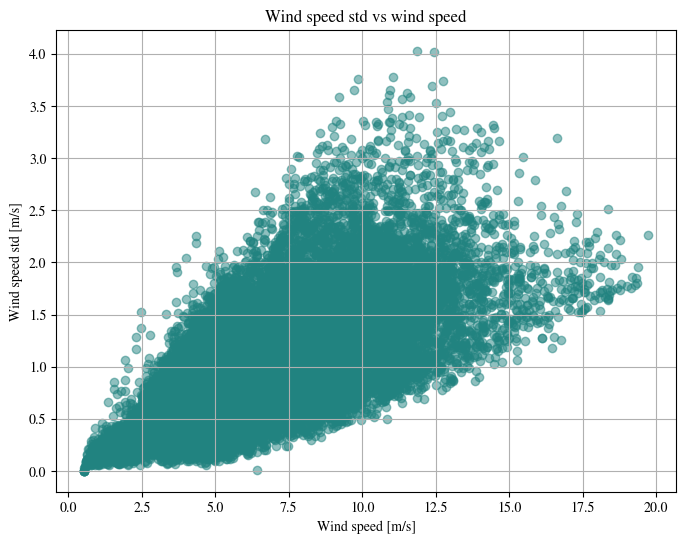

In [46]:
# See the distribution of the wind speed std vs the wind speed mean (lets see if follows the expected trend)
plt.figure(figsize=(8, 6))
plt.scatter(V52_data['Wsp_44m'], V52_data['Wsp_44m_std'], color='#218380', alpha=0.5)

plt.grid(True)

plt.xlabel('Wind speed [m/s]')
plt.ylabel('Wind speed std [m/s]')
plt.title('Wind speed std vs wind speed')

plt.show()

# Very similar to the previus assignment

In [47]:
# Create a new column with the TI
V52_data['TI'] = V52_data['Wsp_44m_std'] / V52_data['Wsp_44m']

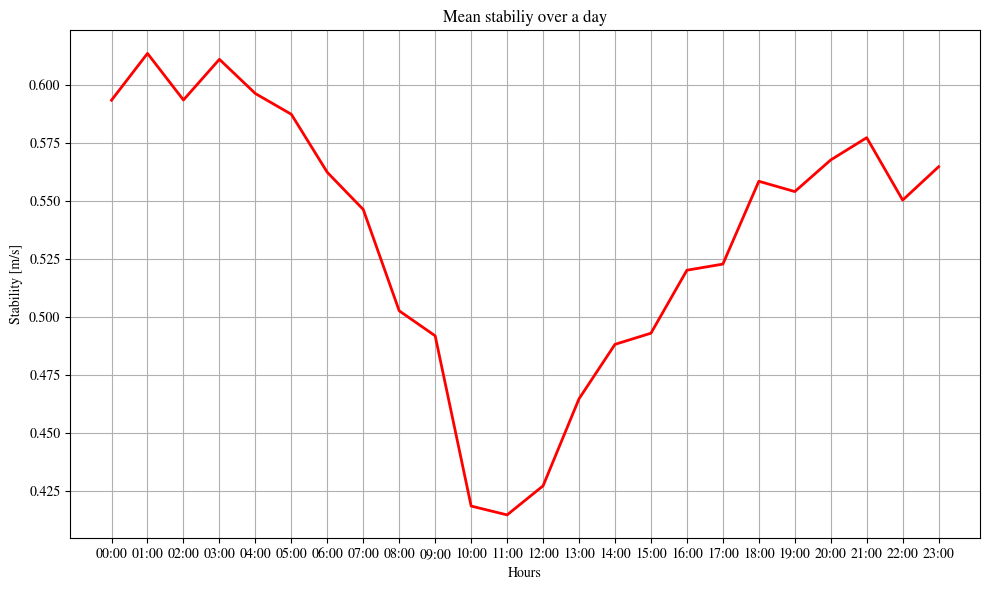

In [48]:
# Create a column containing the hour of the day
V52_data['Hour'] = V52_data.index.hour

# hourly mean stability
HourlyMean_stability =V52_data.groupby(['Hour']).mean()['stability']

# Transform into a DataFrame
HourlyMean_stability = pd.DataFrame({'stability': HourlyMean_stability.values})

# Create a column with the month name
HourlyMean_stability.index = ['00:00', '01:00', '02:00', '03:00', '04:00', '05:00', '06:00', '07:00', '08:00', '09:00', '10:00', '11:00', '12:00', '13:00', '14:00', '15:00', '16:00', '17:00', '18:00', '19:00', '20:00', '21:00', '22:00', '23:00']


# Plot the monthly mean wind speed
plt.figure(figsize=(10,6))
plt.grid()
plt.plot(HourlyMean_stability['stability'], '-', label='hourly mean', color='red', linewidth=2)
plt.xlabel('Hours')
plt.ylabel('Stability [m/s]')
plt.title('Mean stabiliy over a day')
plt.tight_layout()
plt.show()


Este plot es muy interesante... la stability sigue lo que debia seguir... stable conditions within the night (high values of stability) and unstable conditions during the day (low values of stability).

Still doesn not capture seasonality... but it is a good start.

Might need to consider a filter using the stability values

## MISSING TIME STAMPS

In [49]:
missing_time_stamps = pd.date_range(start=V52_data.index[0],end=V52_data.index[-1],freq='10min').difference(V52_data.index)
print('Total number of missing time stamps ', len(missing_time_stamps))
print('Missing time stamps ', missing_time_stamps)

Total number of missing time stamps  321
Missing time stamps  DatetimeIndex(['2018-01-01 13:30:00', '2018-01-01 15:50:00',
               '2018-01-02 20:20:00', '2018-01-03 00:20:00',
               '2018-01-03 18:50:00', '2018-01-04 22:00:00',
               '2018-01-06 18:20:00', '2018-01-06 19:50:00',
               '2018-01-06 20:00:00', '2018-01-07 11:40:00',
               ...
               '2018-11-21 17:20:00', '2018-11-23 17:10:00',
               '2018-11-24 18:30:00', '2018-11-25 17:00:00',
               '2018-11-25 17:10:00', '2018-11-26 20:30:00',
               '2018-12-01 17:10:00', '2018-12-03 23:10:00',
               '2018-12-05 17:00:00', '2018-12-05 19:30:00'],
              dtype='datetime64[ns]', length=321, freq=None)


In [50]:
# Fill the missing time stamps with nan
V52_data = V52_data.reindex(pd.date_range(start=V52_data.index[0],end=V52_data.index[-1],freq='10min'))

# Fill the 'Date' column with the index values
V52_data['Date'] = V52_data.index.strftime('%Y%m%d%H%M')

missing_time_stamps2 = pd.date_range(start=V52_data.index[0],end=V52_data.index[-1],freq='10min').difference(V52_data.index)

# See if there are missing values in the date column
print('Total number of missing time stamps ', len(missing_time_stamps2))

# Set the index to the 'Date' column
V52_data.index = pd.to_datetime(V52_data['Date'], format='%Y%m%d%H%M')

Total number of missing time stamps  0


## DATA FILLING

Jorge Sotana:

I am going to fill the missing data with a different approach.... (ACCORDING TO NICOLAY EMAIL)

1) When 3 consecutive values are missing, I will fill the gaps
2) More than that will not be filled as it will be difficult to extrapolate

In [51]:
# When there are 6 consecutive values of NaN, use backfill function
# make a copy of V52_data
V52_data_filled = V52_data.copy()
V52_data_filled = V52_data.fillna(method='bfill', limit=6)

###################################################################################
def fill_missing_values1(V52_data_filled, column):
    for i in range(len(V52_data_filled[column])):
        if pd.isnull(V52_data_filled[column].iloc[i]):
            surrounding_values = V52_data_filled[column].iloc[max(0, i-10000) : min(len(V52_data_filled), i+10000)]
            meanX = surrounding_values.mean()
            stdX = surrounding_values.std()
            a = np.random.uniform(-1.5, 1.5)
            value = meanX + a*stdX
            # IF VALUE IS NEGATIVE SET TO ZERO OR VALUE IS LARGER THAN 850 SET IT TO 850
            if value < 0:
                value = 0
            elif value > 850:
                value = 850

            V52_data_filled[column].iloc[i] = value

def fill_missing_values2(V52_data_filled, column):
    for i in range(len(V52_data_filled[column])):
        if pd.isnull(V52_data_filled[column].iloc[i]):
            surrounding_values = V52_data_filled[column].iloc[max(0, i-10000) : min(len(V52_data_filled), i+10000)]
            meanX = surrounding_values.mean()
            stdX = surrounding_values.std()
            a = np.random.uniform(-1.5, 1.5)
            value = meanX + a*stdX
            # IF VALUE IS NEGATIVE SET TO ZERO OR VALUE IS LARGER THAN 850 SET IT TO 850
            if value < 0:
                value = 0
            elif value > 25:
                value = 25

            V52_data_filled[column].iloc[i] = value
            
    return V52_data_filled




C:\Users\enriq\AppData\Local\Temp\ipykernel_75724\1894273133.py:4: FutureWarning:

DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.



In [27]:
# create a random number between -2 and 2
np.random.uniform(-2, 2)

-0.46537439466348207

In [52]:
import warnings
warnings.filterwarnings('ignore')
columns_to_fill1 = ['ActPow', 'ActPow_std']  # replace with your column names
columns_to_fill2 = ['Wsp_44m', 'Wsp_44m_std']  # replace with your column names
for column in columns_to_fill1:
    V52_data_filled_M2 = fill_missing_values1(V52_data, column)
for column in columns_to_fill2: 
    V52_data_filled_M2 = fill_missing_values2(V52_data, column)


C:\Users\enriq\AppData\Local\Temp\ipykernel_75724\1894273133.py:21: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\enriq\AppData\Local\Temp\ipykernel_75724\1894273133.py:21: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\enriq\AppData\Local\Temp\ipykernel_75724\1894273133.py:21: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\enriq\AppData\Local\Temp\ipykernel_75724\1894273133.py:21: SettingWithCopyWarning:


A v

In [53]:

# plot in plotly the wind speed
fig = px.line(V52_data_filled, x=V52_data_filled.index, y="ActPow", title='Power of V52')
fig.show()

# plot in plotly the wind speed
fig = px.line(V52_data_filled_M2, x=V52_data_filled_M2.index, y="ActPow", title='Power of V52')
fig.show()
# plot in plotly the wind speed
fig = px.line(V52_data_filled_M2, x=V52_data_filled_M2.index, y="Wsp_44m", title='wind speed')
fig.show()

c:\Users\enriq\AppData\Local\Programs\Python\Python310\lib\site-packages\_plotly_utils\basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



c:\Users\enriq\AppData\Local\Programs\Python\Python310\lib\site-packages\_plotly_utils\basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



c:\Users\enriq\AppData\Local\Programs\Python\Python310\lib\site-packages\_plotly_utils\basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



In [54]:


# Bieeen se ha filleado algo....
# Antes: 35486 no NaN
# Ahora: 37108 no NaN

# Save the standarized datafram to a csv file called V52_data.csv
V52_data_filled.to_csv('V52_data_filledM1.csv',index=False)
V52_data_filled_M2.to_csv('V52_data_filledM2.csv',index=False)
V52_data_filled.describe()

,Wsp_44m,Wdir_41m,ActPow,RePow,ActPow_std,Wsp_44m_std,Wdir_41m_std,stability,TI,Hour
count,38084.000000,38084.000000,38084.000000,38084.000000,38084.000000,3.808400e+04,38084.000000,38084.000000,3.808400e+04,52485.000000
mean,6.253503,194.692564,188.468695,0.047256,50.580327,9.336649e-01,8.386165,0.534319,1.516518e-01,11.503611
std,2.570696,85.730836,217.171871,0.448783,47.759049,5.038456e-01,4.252340,0.498827,6.027582e-02,6.921925
min,0.539690,0.001286,0.000000,-4.625150,0.000000,4.129530e-07,0.000128,0.000000,7.651670e-07,0.000000
25%,4.438398,129.194500,39.455850,-0.001740,18.403800,5.785403e-01,5.744635,0.000000,1.102019e-01,6.000000
50%,5.682735,201.499500,102.552000,-0.000393,33.431050,8.264530e-01,7.405055,1.000000,1.439236e-01,12.000000
75%,7.531395,265.152500,248.801000,0.001373,69.805600,1.178075e+00,9.571775,1.000000,1.830806e-01,18.000000
max,19.720000,359.997000,867.900000,7.717470,408.458000,4.028130e+00,53.438500,1.000000,6.178026e-01,23.000000


In [55]:
V52_data_filled_M2.describe()

,Wsp_44m,Wdir_41m,ActPow,RePow,ActPow_std,Wsp_44m_std,Wdir_41m_std,stability,TI,Hour
count,52561.000000,35486.000000,52561.000000,35486.000000,52561.000000,5.256100e+04,35486.000000,35486.000000,3.548600e+04,52240.000000
mean,6.365835,194.864858,202.244269,0.087797,52.420016,9.527961e-01,8.380105,0.534718,1.514574e-01,11.499081
std,2.462217,85.705501,205.275118,0.374143,45.421969,4.858740e-01,4.180382,0.498800,5.909185e-02,6.924486
min,0.539690,0.001286,0.000000,-4.625150,0.000000,4.129530e-07,0.000128,0.000000,7.651670e-07,0.000000
25%,4.567540,129.248500,45.956000,-0.001487,18.088400,5.897470e-01,5.764972,0.000000,1.105542e-01,5.000000
50%,5.963000,201.874000,130.658000,-0.000277,39.455700,8.740590e-01,7.414105,1.000000,1.439952e-01,11.000000
75%,7.863800,265.377500,307.951159,0.001519,79.605172,1.245790e+00,9.541073,1.000000,1.828086e-01,18.000000
max,19.720000,359.997000,867.900000,7.717470,408.458000,4.028130e+00,53.438500,1.000000,6.178026e-01,23.000000
